In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import geopandas
import folium
from sklearn import preprocessing
import altair as alt
from folium.plugins import HeatMap

## Cleaning and Transforming Data 

In [2]:
# reading and cleaning data
df_nyc = pd.read_csv('airbnb_nyc.csv')

df_nyc = df_nyc.drop(columns = ['calculated_host_listings_count', 'last_review', 'host_name'])

df_nyc.dropna(inplace = True)

df_nyc = df_nyc[df_nyc['availability_365'] != 0]

# filtering outliers
percentile_05 = df_nyc['price'].quantile(.05)
percentile_95 = df_nyc['price'].quantile(.95)

df_nyc = df_nyc[(percentile_05 <= df_nyc['price']) & (df_nyc['price'] <= percentile_95)]

df_nyc = df_nyc.reset_index(drop=True)

In [3]:
df_nyc.to_csv('clean_ny.csv')

In [4]:
neighborhoods = geopandas.read_file('ZillowNeighborhoods-NY.shp')

In [5]:
# filtering new york state shp data for just nyc
nyc = pd.DataFrame()

boroughs = ['Queens', 'Kings', 'New York', 'Bronx', 'Richmond']

for borough in boroughs:
    nyc = pd.concat([nyc, neighborhoods[neighborhoods['County'] == borough]])
    
nyc = nyc.reset_index(drop = True)
nyc = nyc[['Name', 'geometry']].copy()

In [6]:
# mapping differing town names
neighborhood_map = {'Allerton': 'Williamsbridge', 'Battery Park City': 'Battery Park', 'Bay Terrace, Staten Island': 'Bay Terrace',
                   'Bayswater': 'Far Rockaway', 'Bedford-Stuyvesant': 'Bedford Stuyvesant', 'Bronxdale': 'Van Nest',
                   "Bull's Head": 'Bulls Head', 'Civic Center': 'Lower East Side', 'Claremont Village': 'South Bronx',
                   'Columbia St': 'Columbia Street Waterfront District', 'Concord': 'Grasmere - Concord',
                   'Concourse Village': 'Concourse', 'Cypress Hills': 'East New York', 'Ditmars Steinway': 'Astoria',
                   'Douglaston': 'Douglaston-Little Neck', 'Downtown Brooklyn': 'Downtown', 'East Morrisania': 'South Bronx',
                   'Edenwald': 'Eastchester', 'Edgemere': 'Far Rockaway', "Hell's Kitchen": 'Clinton', 'Highbridge': 'High Bridge',
                   'Howland Hook': 'Port Ivory', 'Kips Bay': 'Gramercy', 'Little Neck': 'Douglaston-Little Neck',
                   'Long Island City': 'Hunters Point', 'Mariners Harbor': "Mariner's Harbor", 'Morrisania': 'South Bronx',
                   'Mount Eden': 'Concourse', 'Mount Hope': 'Tremont', 'Nolita': 'Little Italy', 'Olinville': 'Williamsbridge',
                   'Prospect-Lefferts Gardens': 'Prospect Lefferts Gardens', 'Richmondtown': 'Richmond Town', 
                    'Schuylerville': 'Pelham Bay', 'Sea Gate':'Coney Island', 'South Slope': 'Greenwood', 
                    'Theater District': 'Midtown', 'Throgs Neck': 'Throggs Neck', 'Two Bridges': 'Lower East Side',
                    'Westchester Square': 'Westchester Heights'}

df_nyc = df_nyc.replace(neighborhood_map)

## Interactive 1: Choropleth Map of Avg and Max Prices in NYC Neighborhoods

In [7]:
df_nyc.groupby('neighbourhood').min()

,id,name,host_id,neighbourhood_group,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,reviews_per_month,availability_365
neighbourhood,,,,,,,,,,,,
Arden Heights,22730139,1-Bedroom Newly Renovated Cozy Apartment,167595532,Staten Island,40.54857,-74.19626,Entire home/apt,70,1,1,0.90,6
Arrochar,258838,"1BR 2nd floor, house",1360198,Staten Island,40.58796,-74.08047,Entire home/apt,60,1,1,0.09,12
Arverne,581542,*Large 3 bedroom getaway* Pre Summer discounts,519720,Queens,40.58720,-73.80328,Entire home/apt,48,1,1,0.09,2
Astoria,57166,"""Home sweet Home :) """,35375,Queens,40.75384,-73.93641,Entire home/apt,40,1,1,0.02,1
Bath Beach,15191179,"**Cozy room, good location, 20 mins to Manhattan",7958766,Brooklyn,40.59855,-74.01725,Entire home/apt,45,1,1,0.42,17
...,...,...,...,...,...,...,...,...,...,...,...,...
Willowbrook,27088022,"Bright, Brand NEW, and Spacious, Gorgeous Home",115827173,Staten Island,40.59886,-74.13217,Entire home/apt,249,4,9,0.80,351
Windsor Terrace,8505,2 bedroom apartment in front of prospect park,17930,Brooklyn,40.64791,-73.98495,Entire home/apt,42,1,1,0.02,1
Woodhaven,2939670,#1 Hotel-Like Private Room King Bed Near JFK,463061,Queens,40.68540,-73.86778,Entire home/apt,40,1,2,0.30,2


In [8]:
most_freq = df_nyc.groupby('neighbourhood')['room_type'].agg(pd.Series.mode)

In [9]:
# collecting avg and max for neighborhood
avg_price = df_nyc.groupby('neighbourhood').mean()['price']
max_price = df_nyc.groupby('neighbourhood').max()['price']
count_airbnbs = df_nyc.groupby('neighbourhood').count()['id']

# avg and max price and count
nyc = nyc.merge(avg_price, left_on = 'Name', right_on = 'neighbourhood')
nyc = nyc.rename(columns = {'price': 'avg_price'})
nyc = nyc.merge(max_price, left_on = 'Name', right_on = 'neighbourhood')
nyc = nyc.rename(columns = {'price': 'max_price'})
nyc = nyc.merge(count_airbnbs, left_on = 'Name', right_on = 'neighbourhood')
nyc = nyc.rename(columns = {'id': 'num_airbnbs'})

nyc = nyc.round({'avg_price': 2, 'max_price': 2})

/var/folders/l9/gw7j1c_x5r39yqx810j4_2g40000gn/T/ipykernel_8523/1103840694.py:2: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  avg_price = df_nyc.groupby('neighbourhood').mean()['price']


In [10]:
nyc

,Name,geometry,avg_price,max_price,num_airbnbs
0,Rego Park,"POLYGON ((-73.85630 40.72303, -73.85654 40.722...",93.78,288,64
1,Belle Harbor,"POLYGON ((-73.85618 40.56811, -73.85628 40.568...",166.40,225,5
2,Howard Beach,"POLYGON ((-73.85609 40.65037, -73.85675 40.651...",126.08,250,12
3,Breezy Point,"POLYGON ((-73.90963 40.56553, -73.91017 40.564...",195.00,195,2
4,Neponsit,"POLYGON ((-73.85991 40.56701, -73.86071 40.566...",274.67,350,3
...,...,...,...,...,...
197,Castleton Corners,"POLYGON ((-74.12047 40.62204, -74.12012 40.621...",182.00,299,2
198,Arden Heights,"POLYGON ((-74.18997 40.55472, -74.18768 40.554...",76.00,83,3
199,Eltingville,"POLYGON ((-74.16266 40.56059, -74.16234 40.559...",63.00,70,2
200,Richmond Town,"POLYGON ((-74.12087 40.57049, -74.12191 40.569...",78.00,78,1


In [11]:
# might be useful for heatmap?
airbnbs = []
for idx, row in df_nyc.iterrows():
    airbnbs.append((row['latitude'], row['longitude']))

In [12]:
m = nyc.explore(
    column = 'avg_price',
    tooltip = ['Name', 'avg_price', 'num_airbnbs'],
    cmap = 'OrRd',
    name = 'Average AirBnB Price'
)
nyc.explore(m = m, 
            column = 'max_price',
            tooltip = ['Name', 'max_price', 'num_airbnbs'],
            cmap = 'BuPu',
            name = 'Max AirBnB Price')

folium.TileLayer('CartoDB positron', show = False).add_to(m)
folium.LayerControl().add_to(m)
m.save('m.html')

## Interactive 2: Scatterplot for Price Ranges

In [13]:
alt.data_transformers.disable_max_rows()

DataTransformerRegistry.enable('default')

In [46]:
df_nyc
from IPython.display import display, HTML
display(HTML(df_nyc.to_html()))

,id,name,host_id,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,reviews_per_month,availability_365
0,2539,Clean & quiet apt home by the park,2787,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,0.21,365
1,2595,Skylit Midtown Castle,2845,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,0.38,355
2,3831,Cozy Entire Floor of Brownstone,4869,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,4.64,194
3,5099,Large Cozy 1 BR Apartment In Midtown East,7322,Manhattan,Murray Hill,40.74767,-73.97500,Entire home/apt,200,3,74,0.59,129
4,5178,Large Furnished Room Near B'way,8967,Manhattan,Clinton,40.76489,-73.98493,Private room,79,2,430,3.47,220
5,5238,Cute & Cozy Lower East Side 1 bdrm,7549,Manhattan,Chinatown,40.71344,-73.99037,Entire home/apt,150,1,160,1.33,188
6,5295,Beautiful 1br on Upper West Side,7702,Manhattan,Upper West Side,40.80316,-73.96545,Entire home/apt,135,5,53,0.43,6
7,5441,Central Manhattan/near Broadway,7989,Manhattan,Clinton,40.76076,-73.98867,Private room,85,2,188,1.50,39
8,5803,"Lovely Room 1, Garden, Best Area, Legal rental",9744,Brooklyn,Greenwood,40.66829,-73.98779,Private room,89,4,167,1.34,314
9,6021,Wonderful Guest Bedroom in Manhattan for SINGLES,11528,Manhattan,Upper West Side,40.79826,-73.96113,Private room,85,2,113,0.91,333


In [15]:
slider = alt.binding_range(min=0, max=max(df_nyc['price'] + 20), step=20, name=('Price Range'))
selection = alt.param(value=0, bind=slider)

chart1 = alt.Chart(df_nyc).mark_point().encode(
    alt.X('latitude:Q', scale=alt.Scale(domain=[40.45, 40.95])),
    alt.Y('longitude:Q', scale=alt.Scale(domain=[-74.3, -73.7])),
    color=alt.condition(
       alt.datum.price < selection,
       alt.Color('neighbourhood_group:N'),
       alt.value('gray')),
    opacity = alt.condition(
       alt.datum.price < selection,
       alt.value(0.5),
       alt.value(0.1))
).add_params(
   selection
)
chart1

alt.Chart(...)

In [16]:
selection = alt.selection_interval(encodings = ['x'])

chart = alt.Chart(df_nyc).mark_circle().encode(
    y='number_of_reviews:Q',
    x='price:Q',
    color=alt.condition(selection, alt.value('blue'), alt.value('lightgray')),
    tooltip = 'price'
).add_params(
    selection
).properties(
    width = 200,
    height = 200
)

# slider = alt.binding_range(min=0, max=max(df_nyc['price'] + 20), step=20, name=('Price Range'))
# selection = alt.param(value=0, bind=slider)

# chart = alt.Chart(df_nyc).mark_point().encode(
#     alt.X('latitude:Q', scale=alt.Scale(domain=[40.45, 40.95])),
#     alt.Y('longitude:Q', scale=alt.Scale(domain=[-74.3, -73.7])),
#     color=alt.condition(
#        alt.datum.price < selection,
#        alt.Color('neighbourhood_group:N'),
#        alt.value('gray')),
#     opacity = alt.condition(
#        alt.datum.price < selection,
#        alt.value(0.5),
#        alt.value(0.1))
# ).properties(
#     width = 200,
#     height = 200
# ).add_params(
#    selection
# )

df_brooklyn = df_nyc[df_nyc['neighbourhood_group'] == 'Brooklyn']
chart1 = alt.Chart(df_brooklyn).mark_circle().encode(
    alt.X('latitude:Q', scale=alt.Scale(domain=[40.55, 40.75])),
    alt.Y('longitude:Q', scale=alt.Scale(domain=[-74.1, -73.8])),
    alt.Color('neighbourhood_group:N'),
    alt.Tooltip('price')
).properties(
    width = 200,
    height = 200
).transform_filter(
    selection)

df_bronx = df_nyc[df_nyc['neighbourhood_group'] == 'Bronx']
chart2 = alt.Chart(df_bronx).mark_circle().encode(
    alt.X('latitude:Q', scale=alt.Scale(domain=[40.75, 40.95])),
    alt.Y('longitude:Q', scale=alt.Scale(domain=[-73.95, -73.75])),
    alt.Color('neighbourhood_group:N'),
    alt.Tooltip('price')
).properties(
    width = 200,
    height = 200
).transform_filter(
    selection)

df_stat = df_nyc[df_nyc['neighbourhood_group'] == 'Staten Island']
chart3 = alt.Chart(df_stat).mark_circle().encode(
    alt.X('latitude:Q', scale=alt.Scale(domain=[40.45, 40.7])),
    alt.Y('longitude:Q', scale=alt.Scale(domain=[-74.3, -74])),
    alt.Color('neighbourhood_group:N'),
    alt.Tooltip('price')
).properties(
    width = 200,
    height = 200
).transform_filter(
    selection)

df_queens = df_nyc[df_nyc['neighbourhood_group'] == 'Queens']
chart4 = alt.Chart(df_queens).mark_circle().encode(
    alt.X('latitude:Q', scale=alt.Scale(domain=[40.5, 40.85])),
    alt.Y('longitude:Q', scale=alt.Scale(domain=[-74, -73.7])),
    alt.Color('neighbourhood_group:N'),
    alt.Tooltip('price')
).properties(
    width = 200,
    height = 200
).transform_filter(
    selection)

df_man = df_nyc[df_nyc['neighbourhood_group'] == 'Manhattan']
chart5 = alt.Chart(df_man).mark_circle().encode(
    alt.X('latitude:Q', scale=alt.Scale(domain=[40.65, 40.9])),
    alt.Y('longitude:Q', scale=alt.Scale(domain=[-74.1, -73.85])),
    alt.Color('neighbourhood_group:N'),
    alt.Tooltip('price')
).properties(
    width = 200,
    height = 200
).transform_filter(
    selection)

collect = (chart | chart1 | chart2) & (chart3 | chart4 | chart5)
collect = collect.properties(
    title = "Interactive scatter plot to show the relationship between price and number of reviews")

collect.save('collect.html')

## Static 1: Histogram of Title Word Frequency

In [17]:
df_hotels = pd.read_csv('new_york_hotels.csv', encoding='windows-1252')
df_hotels

,ean_hotel_id,name,address1,city,state_province,postal_code,latitude,longitude,star_rating,high_rate,low_rate
0,269955,Hilton Garden Inn Albany/SUNY Area,1389 Washington Ave,Albany,NY,12206,42.68751,-73.81643,3.0,154.0272,124.0216
1,113431,Courtyard by Marriott Albany Thruway,1455 Washington Avenue,Albany,NY,12206,42.68971,-73.82021,3.0,179.0100,134.0000
2,108151,Radisson Hotel Albany,205 Wolf Rd,Albany,NY,12205,42.72410,-73.79822,3.0,134.1700,84.1600
3,254756,Hilton Garden Inn Albany Medical Center,62 New Scotland Ave,Albany,NY,12208,42.65157,-73.77638,3.0,308.2807,228.4597
4,198232,CrestHill Suites SUNY University Albany,1415 Washington Avenue,Albany,NY,12206,42.68873,-73.81854,3.0,169.3900,89.3900
...,...,...,...,...,...,...,...,...,...,...,...
1626,324259,Residence Inn Yonkers Westchester County,7 Executive Blvd,Yonkers,NY,10701,40.97275,-73.88075,3.0,269.3600,169.3600
1627,107949,Ramada Inn Yonkers,125 Tuckahoe Rd,Yonkers,NY,10710,40.95466,-73.86483,2.5,129.0000,119.0000
1628,509723,Hyatt Place New York/Yonkers,7000 Mall Walk,Yonkers,NY,10704,40.92625,-73.85438,3.0,249.3100,199.3100
1629,621870,Hampton Inn & Suites Yonkers - Westchester,555 Tuckahoe Rd,Yonkers,NY,10710,40.95375,-73.84935,2.5,189.1900,134.1800


In [18]:
# filtering new york state shp data for just nyc
nyc_hotels = pd.DataFrame()

boroughs = ['Queens', 'Kings', 'New York', 'Bronx', 'Richmond']

for borough in boroughs:
    nyc_hotels = pd.concat([nyc_hotels, df_hotels[df_hotels['city'] == borough]])
    
nyc_hotels = nyc_hotels.reset_index(drop = True)
nyc_hotels = nyc_hotels.copy()

In [19]:
avg_hotel_price = []
for idx, row in nyc_hotels.iterrows():
    avg_hotel_price.append((nyc_hotels.iloc[idx]['high_rate'] + nyc_hotels.iloc[idx]['low_rate']) / 2)

nyc_hotels['avg_hotel_price'] = avg_hotel_price

gdf_hotels = geopandas.GeoDataFrame(
    nyc_hotels, geometry=geopandas.points_from_xy(nyc_hotels.longitude, nyc_hotels.latitude), crs="EPSG:4326"
)
gdf_hotels

,ean_hotel_id,name,address1,city,state_province,postal_code,latitude,longitude,star_rating,high_rate,low_rate,avg_hotel_price,geometry
0,219370,Dumont NYC-an Affinia hotel,150 E. 34th Street at Lexington Avenue,New York,NY,10016,40.74624,-73.97929,4.0,349.7400,299.2400,324.49000,POINT (-73.97929 40.74624)
1,109277,Park Central New York,870 7th Ave,New York,NY,10019,40.76452,-73.98078,4.0,191.0000,190.0000,190.50000,POINT (-73.98078 40.76452)
2,116103,Blakely New York,136 W 55th St,New York,NY,10019,40.76366,-73.97965,4.5,206.4600,205.4600,205.96000,POINT (-73.97965 40.76366)
3,415836,Pod 39,145 East 39th Street,New York,NY,10016,40.74929,-73.97670,3.0,220.0373,130.0206,175.02895,POINT (-73.97670 40.74929)
4,351449,Sheraton Tribeca New York Hotel,370 Canal Street,New York,NY,10013,40.72102,-74.00418,4.0,350.1800,219.1800,284.68000,POINT (-74.00418 40.72102)
...,...,...,...,...,...,...,...,...,...,...,...,...,...
406,245493,Bronx Guesthouse,East 233 Street,Bronx,NY,10466,40.89192,-73.85267,2.0,202.3000,151.7250,177.01250,POINT (-73.85267 40.89192)
407,393691,Sheridan Hotel,1440 Sheridan Expy,Bronx,NY,10459,40.83114,-73.88481,2.0,198.3900,169.3900,183.89000,POINT (-73.88481 40.83114)
408,466093,Super 8 Bronx,1145 Southern Blvd,Bronx,NY,10459,40.82770,-73.89190,2.0,94.0900,93.0900,93.59000,POINT (-73.89190 40.82770)
409,487266,Residence Inn New York The Bronx At Metro Cent...,1776 Eastchester Rd,Bronx,NY,10461,40.84958,-73.84363,3.0,250.1200,249.1200,249.62000,POINT (-73.84363 40.84958)


In [20]:
nyc

,Name,geometry,avg_price,max_price,num_airbnbs
0,Rego Park,"POLYGON ((-73.85630 40.72303, -73.85654 40.722...",93.78,288,64
1,Belle Harbor,"POLYGON ((-73.85618 40.56811, -73.85628 40.568...",166.40,225,5
2,Howard Beach,"POLYGON ((-73.85609 40.65037, -73.85675 40.651...",126.08,250,12
3,Breezy Point,"POLYGON ((-73.90963 40.56553, -73.91017 40.564...",195.00,195,2
4,Neponsit,"POLYGON ((-73.85991 40.56701, -73.86071 40.566...",274.67,350,3
...,...,...,...,...,...
197,Castleton Corners,"POLYGON ((-74.12047 40.62204, -74.12012 40.621...",182.00,299,2
198,Arden Heights,"POLYGON ((-74.18997 40.55472, -74.18768 40.554...",76.00,83,3
199,Eltingville,"POLYGON ((-74.16266 40.56059, -74.16234 40.559...",63.00,70,2
200,Richmond Town,"POLYGON ((-74.12087 40.57049, -74.12191 40.569...",78.00,78,1


In [21]:
nyc_hotels = gdf_hotels.sjoin(nyc, how="left", predicate="within")

/Users/spezzaferro/anaconda3/lib/python3.11/site-packages/geopandas/geodataframe.py:2187: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:4326
Right CRS: EPSG:4269

  return geopandas.sjoin(left_df=self, right_df=df, *args, **kwargs)  # noqa: B026


In [22]:
nyc_hotels

,ean_hotel_id,name,address1,city,state_province,postal_code,latitude,longitude,star_rating,high_rate,low_rate,avg_hotel_price,geometry,index_right,Name,avg_price,max_price,num_airbnbs
0,219370,Dumont NYC-an Affinia hotel,150 E. 34th Street at Lexington Avenue,New York,NY,10016,40.74624,-73.97929,4.0,349.7400,299.2400,324.49000,POINT (-73.97929 40.74624),123.0,Gramercy,167.07,355.0,320.0
1,109277,Park Central New York,870 7th Ave,New York,NY,10019,40.76452,-73.98078,4.0,191.0000,190.0000,190.50000,POINT (-73.98078 40.76452),108.0,Midtown,181.88,365.0,643.0
2,116103,Blakely New York,136 W 55th St,New York,NY,10019,40.76366,-73.97965,4.5,206.4600,205.4600,205.96000,POINT (-73.97965 40.76366),108.0,Midtown,181.88,365.0,643.0
3,415836,Pod 39,145 East 39th Street,New York,NY,10016,40.74929,-73.97670,3.0,220.0373,130.0206,175.02895,POINT (-73.97670 40.74929),27.0,Murray Hill,177.24,365.0,207.0
4,351449,Sheraton Tribeca New York Hotel,370 Canal Street,New York,NY,10013,40.72102,-74.00418,4.0,350.1800,219.1800,284.68000,POINT (-74.00418 40.72102),110.0,Tribeca,244.67,359.0,49.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
406,245493,Bronx Guesthouse,East 233 Street,Bronx,NY,10466,40.89192,-73.85267,2.0,202.3000,151.7250,177.01250,POINT (-73.85267 40.89192),161.0,Wakefield,85.61,309.0,31.0
407,393691,Sheridan Hotel,1440 Sheridan Expy,Bronx,NY,10459,40.83114,-73.88481,2.0,198.3900,169.3900,183.89000,POINT (-73.88481 40.83114),145.0,Soundview,58.44,103.0,9.0
408,466093,Super 8 Bronx,1145 Southern Blvd,Bronx,NY,10459,40.82770,-73.89190,2.0,94.0900,93.0900,93.59000,POINT (-73.89190 40.82770),138.0,South Bronx,84.25,200.0,28.0
409,487266,Residence Inn New York The Bronx At Metro Cent...,1776 Eastchester Rd,Bronx,NY,10461,40.84958,-73.84363,3.0,250.1200,249.1200,249.62000,POINT (-73.84363 40.84958),153.0,Westchester Heights,66.17,75.0,6.0


In [23]:
nyc_hotels = nyc_hotels[['name', 'Name', 'avg_hotel_price']]
nyc_hotels['stay_type'] = 0
nyc_hotels = nyc_hotels.rename(columns={"name": "id", 'Name': 'neighbourhood', "avg_hotel_price": "price"})

/var/folders/l9/gw7j1c_x5r39yqx810j4_2g40000gn/T/ipykernel_8523/1730554597.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  nyc_hotels['stay_type'] = 0


In [24]:
temp = df_nyc[['id', 'neighbourhood', 'price']]
temp['stay_type'] = 1
temp

/var/folders/l9/gw7j1c_x5r39yqx810j4_2g40000gn/T/ipykernel_8523/828607383.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp['stay_type'] = 1


,id,neighbourhood,price,stay_type
0,2539,Kensington,149,1
1,2595,Midtown,225,1
2,3831,Clinton Hill,89,1
3,5099,Murray Hill,200,1
4,5178,Clinton,79,1
...,...,...,...,...
23802,36411407,Lower East Side,150,1
23803,36425863,Upper East Side,129,1
23804,36427429,Flushing,45,1
23805,36438336,Great Kills,235,1


In [25]:
df_all = pd.concat([nyc_hotels, temp], ignore_index=True, axis=0)

In [26]:
df_all[df_all['neighbourhood'] == 'Gramercy']

,id,neighbourhood,price,stay_type
0,Dumont NYC-an Affinia hotel,Gramercy,324.490,0
166,The Marcel at Gramercy,Gramercy,414.130,0
199,Hotel 17,Gramercy,142.165,0
278,Carlton Arms Hotel,Gramercy,120.990,0
454,14322,Gramercy,200.000,1
...,...,...,...,...
23701,35467734,Gramercy,299.000,1
23800,35582765,Gramercy,132.000,1
24000,35836317,Gramercy,288.000,1
24161,36137740,Gramercy,130.000,1


In [27]:
df_all.to_csv('all_nyc.csv')

In [28]:
df_nyc.head()

,id,name,host_id,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,reviews_per_month,availability_365
0,2539,Clean & quiet apt home by the park,2787,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,0.21,365
1,2595,Skylit Midtown Castle,2845,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,0.38,355
2,3831,Cozy Entire Floor of Brownstone,4869,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,4.64,194
3,5099,Large Cozy 1 BR Apartment In Midtown East,7322,Manhattan,Murray Hill,40.74767,-73.97500,Entire home/apt,200,3,74,0.59,129
4,5178,Large Furnished Room Near B'way,8967,Manhattan,Clinton,40.76489,-73.98493,Private room,79,2,430,3.47,220


In [29]:
df_nyc.head()

,id,name,host_id,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,reviews_per_month,availability_365
0,2539,Clean & quiet apt home by the park,2787,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,0.21,365
1,2595,Skylit Midtown Castle,2845,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,0.38,355
2,3831,Cozy Entire Floor of Brownstone,4869,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,4.64,194
3,5099,Large Cozy 1 BR Apartment In Midtown East,7322,Manhattan,Murray Hill,40.74767,-73.97500,Entire home/apt,200,3,74,0.59,129
4,5178,Large Furnished Room Near B'way,8967,Manhattan,Clinton,40.76489,-73.98493,Private room,79,2,430,3.47,220


In [30]:
nyc_hotels.head()

,id,neighbourhood,price,stay_type
0,Dumont NYC-an Affinia hotel,Gramercy,324.49000,0
1,Park Central New York,Midtown,190.50000,0
2,Blakely New York,Midtown,205.96000,0
3,Pod 39,Murray Hill,175.02895,0
4,Sheraton Tribeca New York Hotel,Tribeca,284.68000,0


In [31]:
df_all.head()

,id,neighbourhood,price,stay_type
0,Dumont NYC-an Affinia hotel,Gramercy,324.49000,0
1,Park Central New York,Midtown,190.50000,0
2,Blakely New York,Midtown,205.96000,0
3,Pod 39,Murray Hill,175.02895,0
4,Sheraton Tribeca New York Hotel,Tribeca,284.68000,0


In [32]:
df_all_copy = df_all.copy()

In [33]:
df_all_copy.shape

(24218, 4)

In [34]:
# Group by neighborhood and calculate average price
avg_prices = df_all_copy.groupby('neighbourhood')['price'].mean().reset_index()
avg_prices.columns = ['neighbourhood', 'avgprice']

# Merge average prices back into the original DataFrame
df_all_average = pd.merge(df_all_copy, avg_prices, on='neighbourhood', how='left')

# Display the DataFrame with the added average price variable
print(df_all_average)

                                    id    neighbourhood      price  stay_type  \
0          Dumont NYC-an Affinia hotel         Gramercy  324.49000          0   
1                Park Central New York          Midtown  190.50000          0   
2                     Blakely New York          Midtown  205.96000          0   
3                               Pod 39      Murray Hill  175.02895          0   
4      Sheraton Tribeca New York Hotel          Tribeca  284.68000          0   
...                                ...              ...        ...        ...   
24213                         36411407  Lower East Side  150.00000          1   
24214                         36425863  Upper East Side  129.00000          1   
24215                         36427429         Flushing   45.00000          1   
24216                         36438336      Great Kills  235.00000          1   
24217                         36442252       Mott Haven  100.00000          1   

         avgprice  
0      

In [35]:
df_all_average.to_csv('df_all_average.csv', index=False)

In [36]:
df_nyc.head()

,id,name,host_id,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,reviews_per_month,availability_365
0,2539,Clean & quiet apt home by the park,2787,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,0.21,365
1,2595,Skylit Midtown Castle,2845,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,0.38,355
2,3831,Cozy Entire Floor of Brownstone,4869,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,4.64,194
3,5099,Large Cozy 1 BR Apartment In Midtown East,7322,Manhattan,Murray Hill,40.74767,-73.97500,Entire home/apt,200,3,74,0.59,129
4,5178,Large Furnished Room Near B'way,8967,Manhattan,Clinton,40.76489,-73.98493,Private room,79,2,430,3.47,220


In [37]:
williamsburg_data = df_nyc[(df_nyc['neighbourhood'] == 'Williamsburg') & (df_nyc['room_type'] == 'Entire home/apt')]

In [38]:
williamsburg_data.shape

(871, 13)

Below, we'll filter the df_nyc dataframe in order calculate average airbnb stay prices for our D3 visualization

In [39]:
# Find average price per neighborhood from the df_nyc dataframe
average_price_per_neighborhood = df_nyc.groupby('neighbourhood')['price'].mean().reset_index()

# Rename the columns for clarity
average_price_per_neighborhood.columns = ['Neighborhood', 'AveragePrice']

average_price_per_neighborhood.head()

,Neighborhood,AveragePrice
0,Arden Heights,76.000000
1,Arrochar,125.583333
2,Arverne,150.000000
3,Astoria,99.688817
4,Bath Beach,82.833333


In [40]:
average_price_per_neighborhood.shape

(196, 2)

In [41]:
top_10_prices = average_price_per_neighborhood.sort_values(by='AveragePrice', ascending=False).head(10)

In [42]:
top_10_prices.head()

,Neighborhood,AveragePrice
121,Neponsit,274.666667
191,Willowbrook,249.000000
174,Tribeca,244.673469
63,Flatiron District,216.107143
125,NoHo,214.896552


In [43]:
# Save the DataFrame to a CSV file
#top_10_prices.to_csv("topairbnbprices2.csv", index=False)

Histogram of Price Range in AirBnbs in NYC

Text(0.5, 1.0, 'Distribution of Price per Night of AirBnbs in NYC')

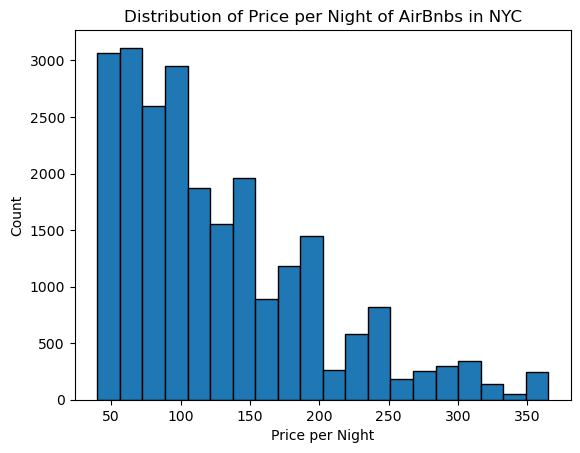

In [44]:
import matplotlib.pyplot as plt
plt.hist(df_nyc['price'], bins = 20, edgecolor = 'black')

plt.xlabel('Price per Night')
plt.ylabel('Count')
plt.title('Distribution of Price per Night of AirBnbs in NYC')

Boxplot of Room Types vs Price

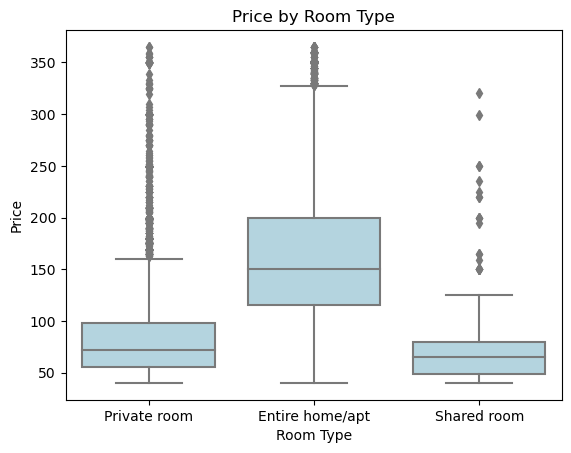

In [45]:
import seaborn as sns

colors = {'lightblue', 'lightblue', 'lightblue'}

sns.boxplot(x = 'room_type', y = 'price', data = df_nyc, palette = colors)

plt.xlabel('Room Type')
plt.ylabel('Price')
plt.title('Price by Room Type')

plt.show()
